#Configuracion

In [ ]:
#Pueden utiilizar la funcion convolve de scipy para realizar las convoluciones necesarias
from scipy import ndimage
from skimage import filters
from skimage import util
import skimage.io as io
from skimage import exposure
from skimage import img_as_ubyte
from skimage import img_as_float



import matplotlib.pyplot as plt
import numpy as np

import os

#Imagenes de color RGB
Las imagenes digitales a color estaran compuestas por 3 dimensiones, cada una representando un canal diferente de color.

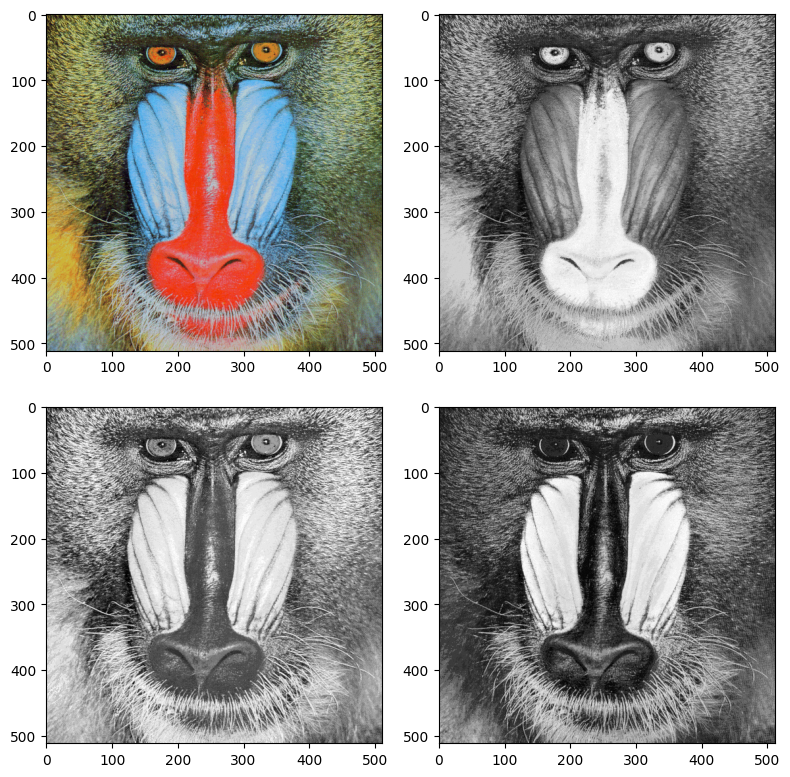

In [ ]:
# Indicamos el camino a la imagen
imagenFilename = os.path.join("/content/Imagenes", 'mandril_color.tif')
# Abrimos la imagen sin pasarla a escala de gris.
imagenPrueba = io.imread(imagenFilename)

fig, axes = plt.subplots(2, 2, figsize=(8, 8))
ax = axes.ravel()

ax[0].imshow(imagenPrueba) # Imagen Compuesta
ax[1].imshow(imagenPrueba[:,:,0], cmap=plt.cm.gray) # Canal Rojo
ax[2].imshow(imagenPrueba[:,:,1], cmap=plt.cm.gray) # Canal Verde
ax[3].imshow(imagenPrueba[:,:,2], cmap=plt.cm.gray) # Canal Azul

fig.tight_layout()
plt.show()

# [FINALIZADO] Histograma Por Canal



In [ ]:
def histogramasPorCanalRGB(image):
  histogramaR, _ = np.histogram(image[:,:,0], bins=256, range=(0, 256))
  histogramaG, _ = np.histogram(image[:,:,1], bins=256, range=(0, 256))
  histogramaB, _ = np.histogram(image[:,:,2], bins=256, range=(0, 256))

  return histogramaR,histogramaG,histogramaB


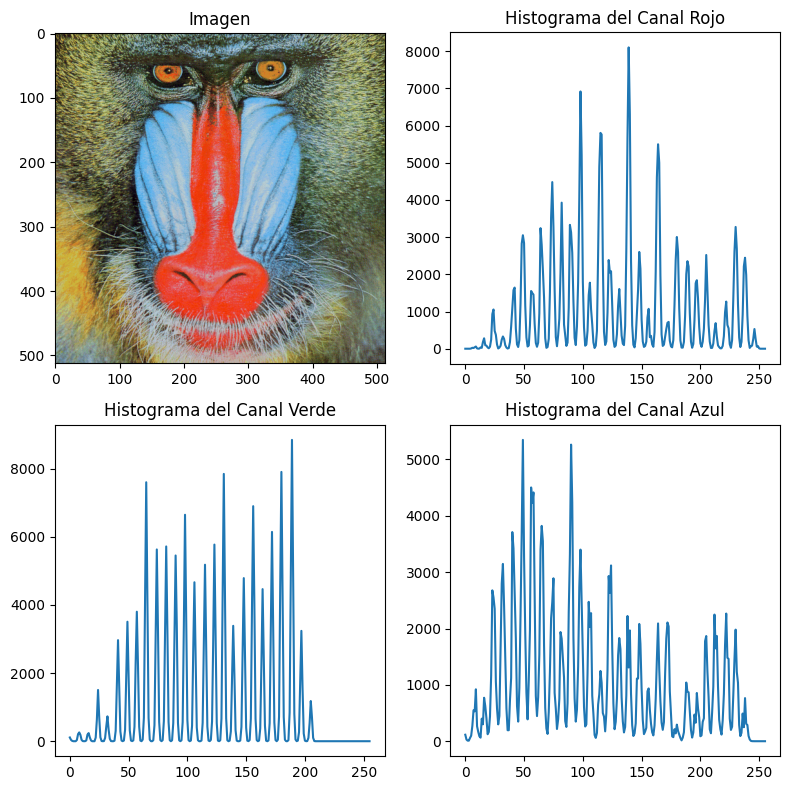

In [ ]:
imagenFilename = os.path.join("/content/Imagenes", 'mandril_color.tif')
imagenPrueba = io.imread(imagenFilename)
histR, histG, histB = histogramasPorCanalRGB(imagenPrueba)

# Mostramos el resultado final
fig, axes = plt.subplots(2, 2, figsize=(8, 8))
ax = axes.ravel()

# Usamos imshow para graficar imagenes, utilizando el cmap plt.cm.gray para especificar que esta en escala de grises
ax[0].imshow(imagenPrueba)
ax[0].set_title('Imagen')
ax[1].plot(range(256), histR)
ax[1].set_title('Histograma del Canal Rojo')
ax[2].plot(range(256), histG)
ax[2].set_title('Histograma del Canal Verde')
ax[3].plot(range(256), histB)
ax[3].set_title('Histograma del Canal Azul')

fig.tight_layout()
plt.show()


# [FINALIZADO] Ecualizacion de Histograma por Canal
Realizar la ecualizacion por cada uno de los canales y mostrar las imagenes resultantes del modificar un histograma y mantener los otros 2. Por ultimo, imprimir la imagen con sus 3 canales ecualizados.

*(ayuda: pueden utilizar exposure.equalize_hist(img))*

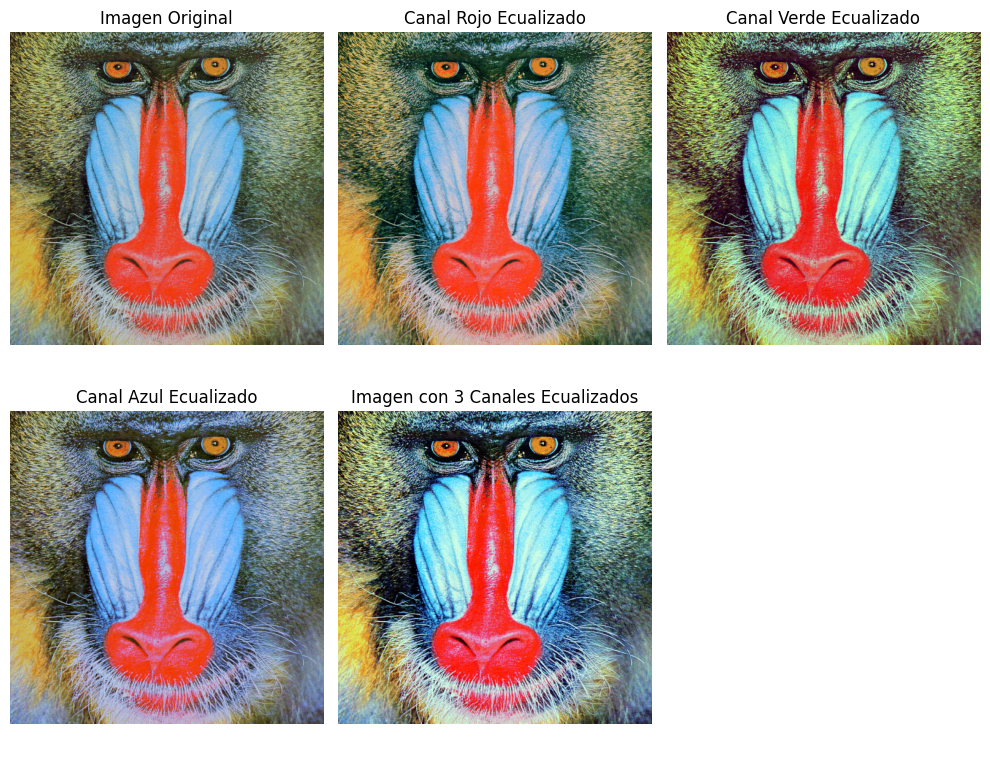

In [ ]:
# Cargar la imagen
imagenFilename = os.path.join("/content/Imagenes", 'mandril_color.tif')
imagenPrueba = io.imread(imagenFilename)

# Creamos los vectores donde guardar las imágenes ecualizadas
imgEcualizadaRojo = imagenPrueba.copy()
imgEcualizadaVerde = imagenPrueba.copy()
imgEcualizadaAzul = imagenPrueba.copy()
imgEcualizada = imagenPrueba.copy()

# Ecualizamos el canal rojo
canalRojoEcualizado = exposure.equalize_hist(imagenPrueba[:, :, 0])
imgEcualizadaRojo[:, :, 0] = img_as_ubyte(canalRojoEcualizado)

# Ecualizamos el canal verde
canalVerdeEcualizado = exposure.equalize_hist(imagenPrueba[:, :, 1])
imgEcualizadaVerde[:, :, 1] = img_as_ubyte(canalVerdeEcualizado)

# Ecualizamos el canal azul
canalAzulEcualizado = exposure.equalize_hist(imagenPrueba[:, :, 2])
imgEcualizadaAzul[:, :, 2] = img_as_ubyte(canalAzulEcualizado)

#Ecualizamos los 3
imgEcualizada[:, :, 0] = img_as_ubyte(canalRojoEcualizado)
imgEcualizada[:, :, 1] = img_as_ubyte(canalVerdeEcualizado)
imgEcualizada[:, :, 2] = img_as_ubyte(canalAzulEcualizado)

# Ploteamos
fig, axes = plt.subplots(2, 3, figsize=(10, 8))
ax = axes.ravel()

ax[0].imshow(imagenPrueba)
ax[0].set_title("Imagen Original")

ax[1].imshow(imgEcualizadaRojo)
ax[1].set_title("Canal Rojo Ecualizado")

ax[2].imshow(imgEcualizadaVerde)
ax[2].set_title("Canal Verde Ecualizado")

ax[3].imshow(imgEcualizadaAzul)
ax[3].set_title("Canal Azul Ecualizado")

ax[4].imshow(imgEcualizada)
ax[4].set_title("Imagen con 3 Canales Ecualizados")

# Ajustes finales
for a in ax:
    a.axis('off')

plt.tight_layout()
plt.show()


#Conversion HSI a RGB y viceversa

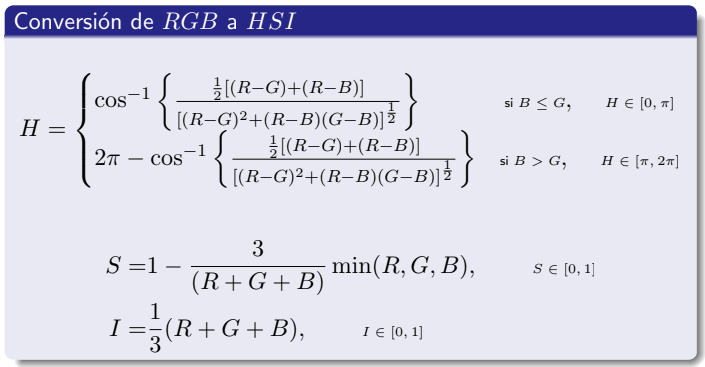


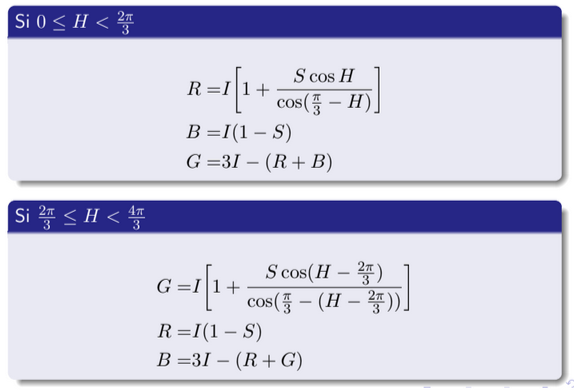

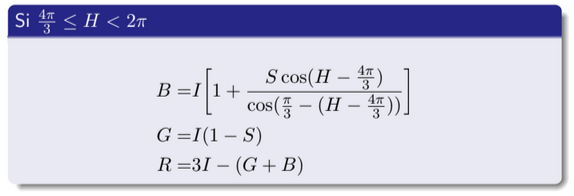



In [ ]:
def RGBaHSI(image):
    rgbNormalizado = img_as_float(image)
    R = rgbNormalizado[:, :, 0]
    G = rgbNormalizado[:, :, 1]
    B = rgbNormalizado[:, :, 2]

    # Cálculo de la intensidad
    I = (R + G + B) / 3

    # Cálculo de la saturación
    min_rgb = np.minimum(np.minimum(R, G), B)
    S = 1 - (3* min_rgb / ((R+G+B) + 1e-10))  # Evitamos divisiones por cero

    # Cálculo del ángulo H (Matiz)
    num = ((R - G) + (R - B)) * (1/2)
    den = np.sqrt((R - G) ** 2 + (R - B) * (G - B))
    cos_theta = num / (den + 1e-10)
    H = np.arccos(cos_theta)

    # Ajustamos H donde B > G
    H[B > G] = 2 * np.pi - H[B > G]

    # Ajustamos H donde B <= G (redundante, ya lo hicimos arriba)
    H[B <= G] = H[B<=G]

    ## Normalizamos el ángulo H a [0, 1]
    ##H /= 2 * np.pi

    return np.stack((H, S, I), axis=2)


(Versión lole)

In [ ]:
def HSIaRGB(image):
    H = image[:, :, 0]
    S = image[:, :, 1]
    I = image[:, :, 2]

    R = np.zeros_like(H)
    G = np.zeros_like(H)
    B = np.zeros_like(H)

    # Máscara para 0 <= H < π/3
    mask1 = (H >= 0) & (H < 2*np.pi / 3)
    B[mask1] = I[mask1] * (1 - S[mask1])
    R[mask1] = I[mask1] * (1 + (S[mask1] * np.cos(H[mask1])) / np.cos((np.pi / 3) - H[mask1]))
    G[mask1] = 3 * I[mask1] - (R[mask1] + B[mask1])

    # Máscara para 2π/3 <= H < 4π/3
    mask2 = (H >= 2*np.pi / 3) & (H < 4 * np.pi / 3)
    R[mask2] = I[mask2] * (1 - S[mask2])
    G[mask2] = I[mask2] * (1 + (S[mask2] * np.cos(H[mask2] - 2*(np.pi / 3)) /
                           np.cos((np.pi / 3) - (H[mask2]))))
    B[mask2] = 3 * I[mask2] - (R[mask2] + G[mask2])

    # Máscara para 4π/3 <= H < 2π
    mask3 = (H >= 4 * np.pi / 3) & (H < 2 * np.pi)
    G[mask3] = I[mask3] * (1 - S[mask3])
    B[mask3] = I[mask3] * (1 + (S[mask3] * np.cos(H[mask3] - 4 * np.pi / 3)) /
                           np.cos(np.pi / 3 - (H[mask3])))
    R[mask3] = 3 * I[mask3] - (G[mask3] + B[mask3])

    # Aseguramos que los valores estén en el rango [0, 1]
    RGB = np.stack((R, G, B), axis=2)
    RGB = np.clip(RGB, 0, 1)

    return img_as_ubyte(RGB)


### Probamos si estan bien las funciones

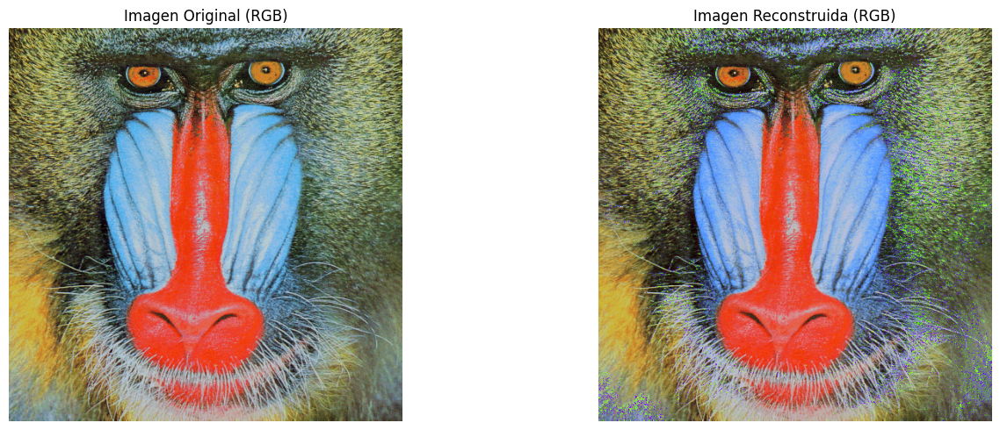

In [ ]:
imageHSI = RGBaHSI(imagenPrueba)
imageRGBReconstruida = HSIaRGB(imageHSI)
fig, axes = plt.subplots(1, 2, figsize=(15, 5))

axes[0].imshow(imagenPrueba)
axes[0].set_title("Imagen Original (RGB)")
axes[0].axis('off')

axes[1].imshow(imageRGBReconstruida)
axes[1].set_title("Imagen Reconstruida (RGB)")
axes[1].axis('off')

plt.tight_layout()
plt.show()


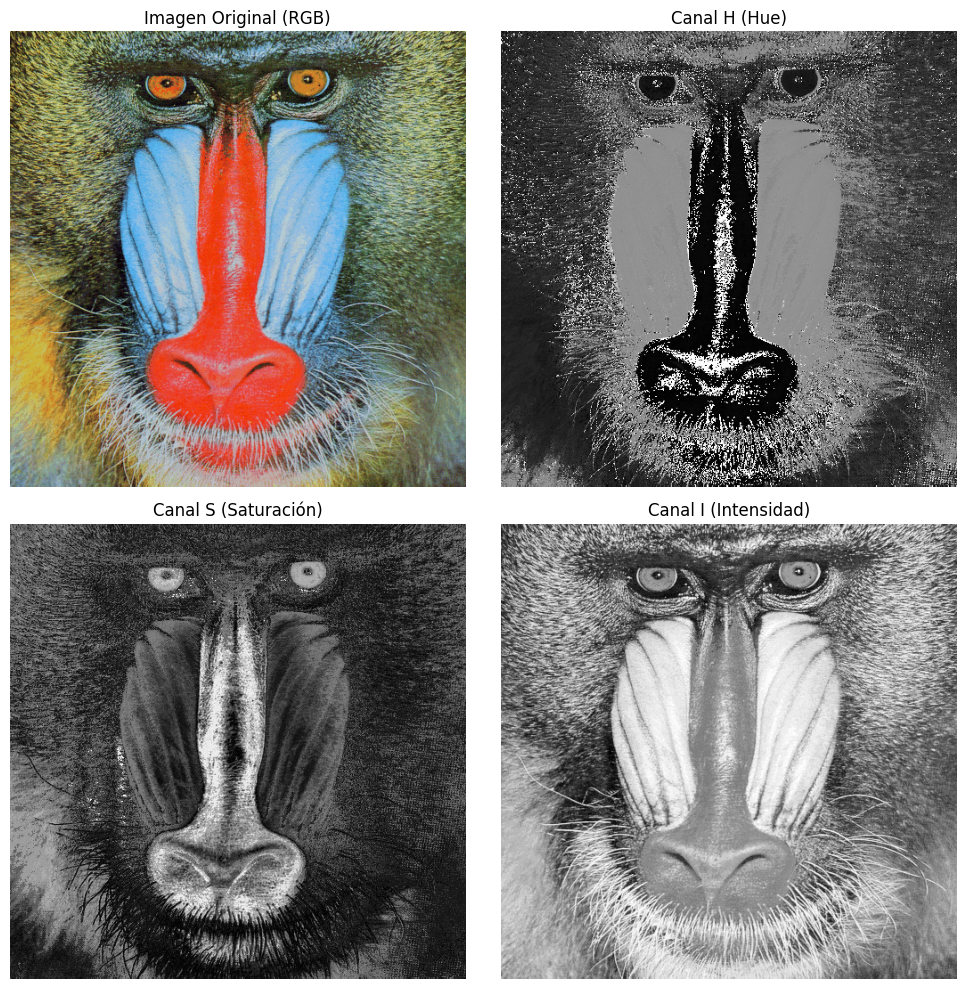

In [ ]:
imagenFilename = os.path.join("/content/Imagenes", 'mandril_color.tif')
imagenPrueba = io.imread(imagenFilename)

imageHSI = RGBaHSI(imagenPrueba)  # Convertir a HSI

fig, axes = plt.subplots(2, 2, figsize=(10, 10))
ax = axes.ravel()
ax[0].imshow(imagenPrueba)
ax[0].set_title("Imagen Original (RGB)")
ax[0].axis('off')

ax[1].imshow(imageHSI[:, :, 0], cmap=plt.cm.gray)
ax[1].set_title("Canal H (Hue)")
ax[1].axis('off')

ax[2].imshow(imageHSI[:, :, 1], cmap=plt.cm.gray)
ax[2].set_title("Canal S (Saturación)")
ax[2].axis('off')

ax[3].imshow(imageHSI[:, :, 2], cmap=plt.cm.gray)
ax[3].set_title("Canal I (Intensidad)")
ax[3].axis('off')

plt.tight_layout()
plt.show()


# Ecualizacion de Intensidad

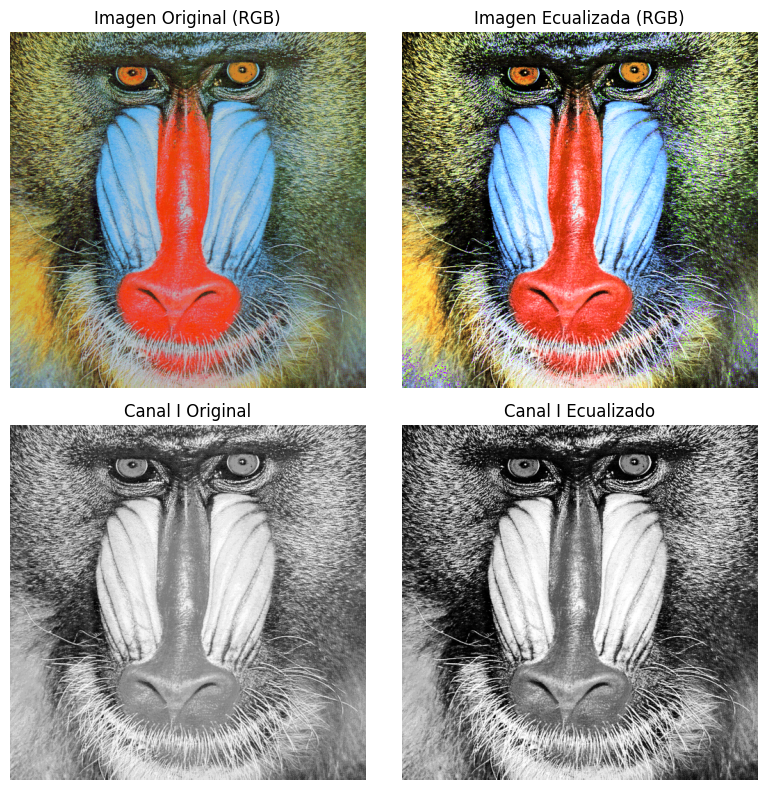

In [ ]:
# Cargar la imagen y convertirla a HSI
imagenFilename = os.path.join("/content/Imagenes", 'mandril_color.tif')
imagenPrueba = io.imread(imagenFilename)

# Convertir la imagen de RGB a HSI
imageHSI = RGBaHSI(imagenPrueba)

# Crear una copia para ecualizar el canal I (Intensidad)
imageHSIEcualizada = imageHSI.copy()

# Ecualizar el canal I utilizando exposure.equalize_hist
imageHSIEcualizada[:, :, 2] = exposure.equalize_hist(imageHSI[:, :, 2])

# Convertir la imagen HSI ecualizada de vuelta a RGB
imageRGBEcualizada = HSIaRGB(imageHSIEcualizada)

# Visualizar las imágenes
fig, axes = plt.subplots(2, 2, figsize=(8, 8))
ax = axes.ravel()

ax[0].imshow(imagenPrueba)
ax[0].set_title("Imagen Original (RGB)")
ax[0].axis('off')

ax[1].imshow(imageRGBEcualizada)
ax[1].set_title("Imagen Ecualizada (RGB)")
ax[1].axis('off')

ax[2].imshow(imageHSI[:, :, 2], cmap=plt.cm.gray)
ax[2].set_title("Canal I Original")
ax[2].axis('off')

ax[3].imshow(imageHSIEcualizada[:, :, 2], cmap=plt.cm.gray)
ax[3].set_title("Canal I Ecualizado")
ax[3].axis('off')

plt.tight_layout()
plt.show()

# Operadores Puntales en HSI
Escriban sus propios operadores puntuales y apliquen diferentes operaciones a cada canal por separado, estudiando como resulta la imagen al volver a RGB.

*(ayuda: utilizar la funcion np.vectorize para convertir una funcion puntual en un operador para toda la matriz. El resultado de la funcion siempre debe estar entre 0 y 1)*

In [ ]:
#Funcion de ejemplo que invierte el valor, suponiendo que esta en escala (0,1)
def operadorEjemplo1(pixel):
  return 1-pixel

#Funcion de ejemplo que duplica el valor actual
def operadorEjemplo2(pixel):
  return max(min(2*pixel,1.0),0.0)

# Operador que aplica una función exponencial al canal de intensidad
def aumentarIntensidadExponencial(pixel):
    return np.clip(np.exp(pixel) - 1, 0, 1)

# Operador que aplica una función senoidal al matiz (H)
def transformarMatizSeno(pixel):
    return np.clip((np.sin(2 * np.pi * pixel) + 1) / 2, 0, 1)

# Convertir las funciones puntuales en operadores para toda la matriz usando np.vectorize
operadorInvertir = np.vectorize(operadorEjemplo1)
operadorSaturacion = np.vectorize(operadorEjemplo2)
operadorIntensidad = np.vectorize(aumentarIntensidadExponencial)
operadorMatiz = np.vectorize(transformarMatizSeno)


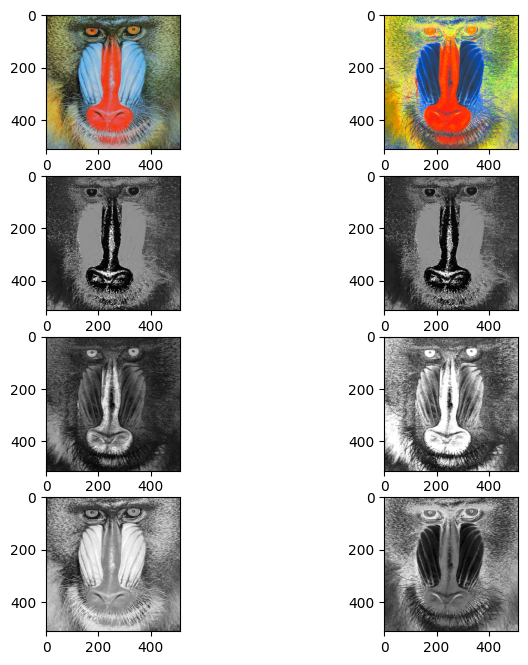

In [ ]:
imagenFilename = os.path.join("/content/Imagenes", 'mandril_color.tif')
imagenPrueba = io.imread(imagenFilename)
operadorPuntualEjemplo1 = np.vectorize(operadorEjemplo1)
operadorPuntualEjemplo2 = np.vectorize(operadorEjemplo2)

imageHSI = RGBaHSI(imagenPrueba)
imageHSIModificada = imageHSI.copy()
imageHSIModificada[:,:,1] = operadorPuntualEjemplo2(imageHSIModificada[:,:,1])
imageHSIModificada[:,:,2] = operadorPuntualEjemplo1(imageHSIModificada[:,:,2])

imageRGBModificada = HSIaRGB(imageHSIModificada)

fig, axes = plt.subplots(4, 2, figsize=(8, 8))
ax = axes.ravel()

ax[0].imshow(imagenPrueba)
ax[1].imshow(imageRGBModificada)

ax[2].imshow(imageHSI[:,:,0], cmap=plt.cm.gray)
ax[3].imshow(imageHSIModificada[:,:,0], cmap=plt.cm.gray)

ax[4].imshow(imageHSI[:,:,1], cmap=plt.cm.gray)
ax[5].imshow(imageHSIModificada[:,:,1], cmap=plt.cm.gray)

ax[6].imshow(imageHSI[:,:,2], cmap=plt.cm.gray)
ax[7].imshow(imageHSIModificada[:,:,2], cmap=plt.cm.gray)

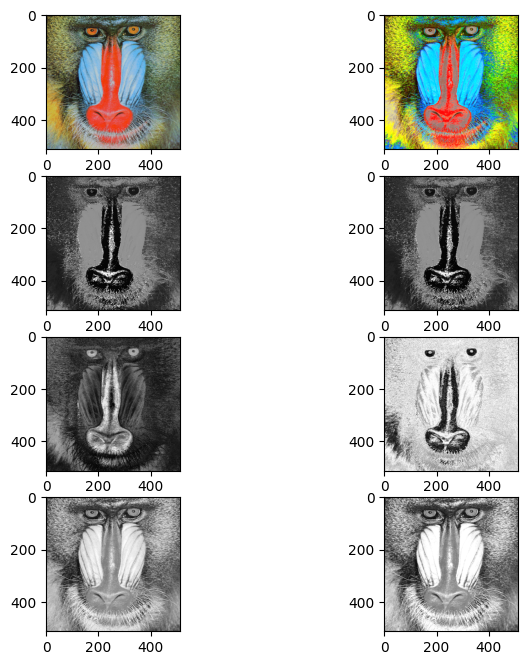

In [ ]:
imagenFilename = os.path.join("/content/Imagenes", 'mandril_color.tif')
imagenPrueba = io.imread(imagenFilename)
operadorPuntualEjemplo1 = np.vectorize(operadorEjemplo1)
operadorPuntualEjemplo2 = np.vectorize(operadorEjemplo2)

imageHSI = RGBaHSI(imagenPrueba)
imageHSIModificada = imageHSI.copy()
imageHSIModificada[:,:,1] = transformarMatizSeno(imageHSIModificada[:,:,1])
imageHSIModificada[:,:,2] = aumentarIntensidadExponencial(imageHSIModificada[:,:,2])

imageRGBModificada = HSIaRGB(imageHSIModificada)

fig, axes = plt.subplots(4, 2, figsize=(8, 8))
ax = axes.ravel()

ax[0].imshow(imagenPrueba)
ax[1].imshow(imageRGBModificada)

ax[2].imshow(imageHSI[:,:,0], cmap=plt.cm.gray)
ax[3].imshow(imageHSIModificada[:,:,0], cmap=plt.cm.gray)

ax[4].imshow(imageHSI[:,:,1], cmap=plt.cm.gray)
ax[5].imshow(imageHSIModificada[:,:,1], cmap=plt.cm.gray)

ax[6].imshow(imageHSI[:,:,2], cmap=plt.cm.gray)
ax[7].imshow(imageHSIModificada[:,:,2], cmap=plt.cm.gray)

#Realce de Saturacion
Multiplicar por una constante c > 1 cada pixel en el plano de la saturacion. Ver que esto aumenta la intensidad aparente.

Si c < 1 ver que reduce la intensidad del color.

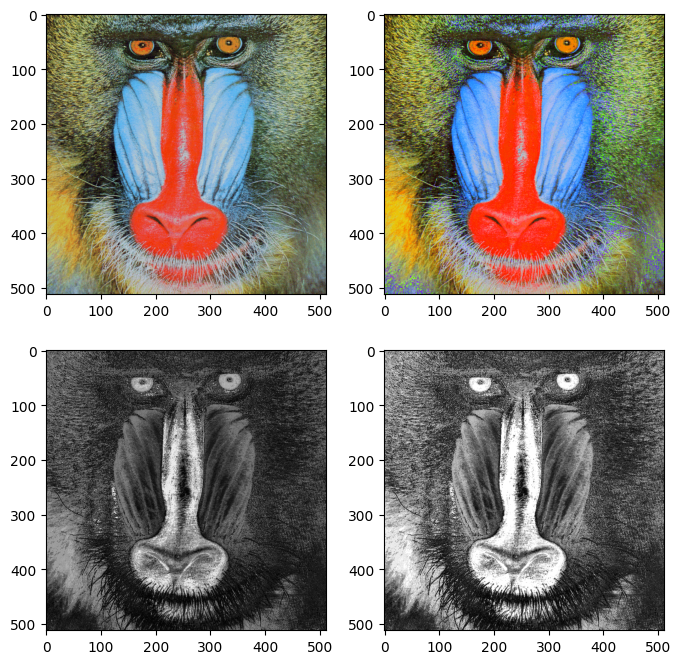

In [ ]:
imagenFilename = os.path.join("/content/Imagenes", 'mandril_color.tif')
imagenPrueba = io.imread(imagenFilename)

imageHSI = RGBaHSI(imagenPrueba)
imageHSIModificada = imageHSI.copy()
imageHSIModificada[:,:,1] = np.clip(imageHSIModificada[:,:,1]*1.5,0,1)
# Asegurense que la Saturacion se encuentra en el rango (0,1) luego de aplicar la transformacion
imageRGBModificada = HSIaRGB(imageHSIModificada)

fig, axes = plt.subplots(2, 2, figsize=(8, 8))
ax = axes.ravel()

ax[0].imshow(imagenPrueba)
ax[1].imshow(imageRGBModificada)

ax[2].imshow(imageHSI[:,:,1], cmap=plt.cm.gray)
ax[3].imshow(imageHSIModificada[:,:,1], cmap=plt.cm.gray)

# Saturamos no-linealmente

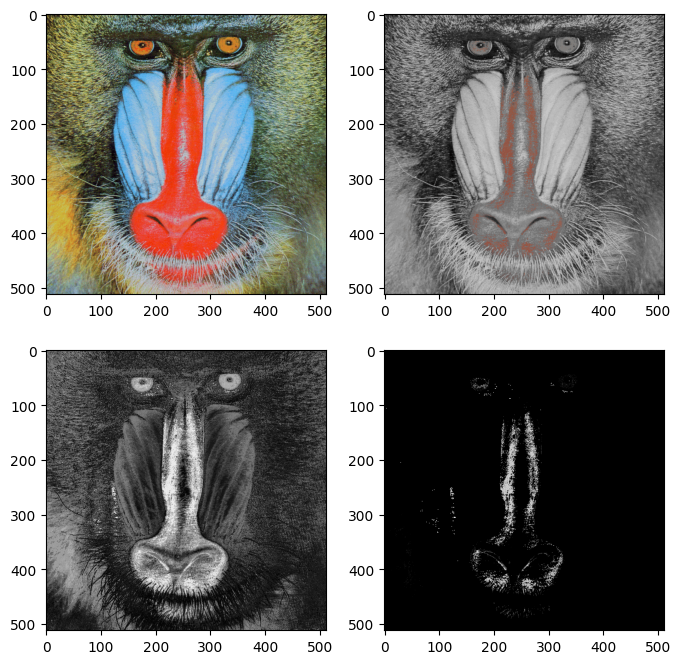

In [ ]:
imagenFilename = os.path.join("/content/Imagenes", 'mandril_color.tif')
imagenPrueba = io.imread(imagenFilename)

imageHSI = RGBaHSI(imagenPrueba)
imageHSIModificada = imageHSI.copy()
imageHSIModificada[:,:,1] = np.clip(np.log(imageHSIModificada[:,:,1]*1.5),0,1) ##Operacion no lineal, aplico logaritmo
# Asegurense que la Saturacion se encuentra en el rango (0,1) luego de aplicar la transformacion
imageRGBModificada = HSIaRGB(imageHSIModificada)

fig, axes = plt.subplots(2, 2, figsize=(8, 8))
ax = axes.ravel()

ax[0].imshow(imagenPrueba)
ax[1].imshow(imageRGBModificada)

ax[2].imshow(imageHSI[:,:,1], cmap=plt.cm.gray)
ax[3].imshow(imageHSIModificada[:,:,1], cmap=plt.cm.gray)

#Alteracion de Hue (cambio de tono)
Sumar la constante c a los valores del canal H y ver el efecto en los colores cuando c es muy chico yque sucede cuando c es muy grande.

(ayuda: Recordar que el tono representa un angulo en la *rueda de color*, donde 0 = 0 y 1 = 2π. Si al sumar una constante el valor es mayor a 1, el angulo deberia *dar la vuelta* como las manijas de un reloj. Lo mismo si c es negativo)

Por ejemplo, si c fuera 0.5, es decir sumar el angulo π, la transformacion tendria la forma:

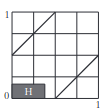

In [ ]:
def cambioDeTono(tonoPixel, c):
  tonoPixel = (tonoPixel + c) % 1
  return tonoPixel

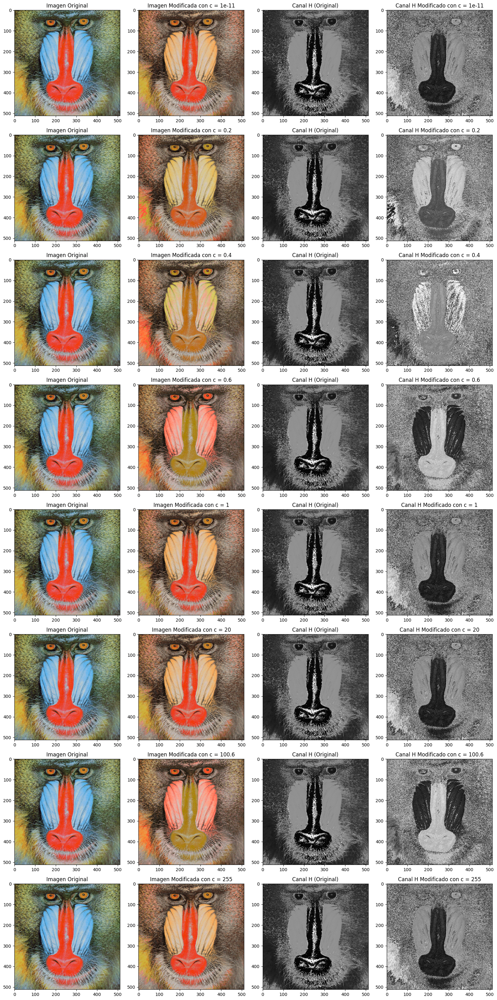

In [ ]:
valores_c = [0.00000000001, 0.2, 0.4, 0.6, 1, 20, 100.6, 255] # Hay cierta periodicidad [0,1]
imagenFilename = os.path.join("/content/Imagenes", 'mandril_color.tif')
imagenPrueba = io.imread(imagenFilename)

imageHSI = RGBaHSI(imagenPrueba)

fig, axes = plt.subplots(len(valores_c), 4, figsize=(16, 4 * len(valores_c)))

for i, c in enumerate(valores_c):
    imageHSIModificada = imageHSI.copy()

    operadorPuntualCambioDeTono = np.vectorize(cambioDeTono)
    imageHSIModificada[:, :, 0] = operadorPuntualCambioDeTono(imageHSIModificada[:, :, 0], c)

    imageRGBModificada = HSIaRGB(imageHSIModificada)

    axes[i, 0].imshow(imagenPrueba)
    axes[i, 0].set_title("Imagen Original")

    axes[i, 1].imshow(imageRGBModificada)
    axes[i, 1].set_title(f"Imagen Modificada con c = {c}")

    axes[i, 2].imshow(imageHSI[:, :, 0], cmap=plt.cm.gray)
    axes[i, 2].set_title("Canal H (Original)")

    axes[i, 3].imshow(imageHSIModificada[:, :, 0], cmap=plt.cm.gray)
    axes[i, 3].set_title(f"Canal H Modificado con c = {c}")

plt.tight_layout()
plt.show()

#Analisis por Canal
Ver cual es el canal donde los detalles son mas visibles y en en cual es mas distinguible un granulado en una imagen.

Ver a cual de los canales afectan mas los bordes difuminados.

Para este punto utilizar el data set de imagenes debajo del agua subidas al campus. Realicen ecualizacion en el canal necesario para resaltar los detalles de las imagenen, comparen con las imagenes ya post procesadas subidas al campus.

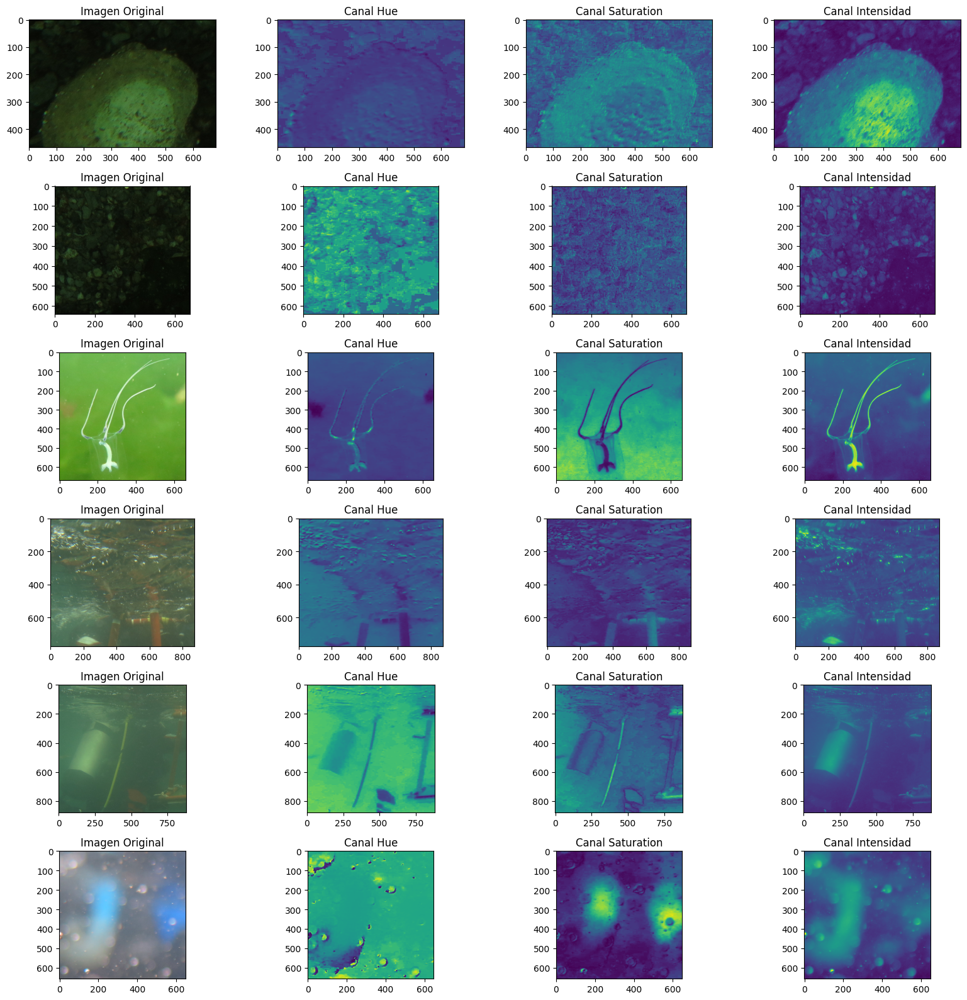

In [ ]:
# Agarro algunas imagenes
imagenes = ["1892xx.png","1892xxx.png","1901xx.png","1906ax.png","1908iv.png","1908xx.png","1923xx.png","1908xxx.png"]

fig, axes = plt.subplots(len(imagenes), 4, figsize=(16,16))

for i,imagen in enumerate(imagenes):
  imagenFilename = os.path.join("/content/Imagenes/reales", imagen)
  imagenPrueba = io.imread(imagenFilename)

  imageHSI = RGBaHSI(imagenPrueba)

  axes[i, 0].imshow(imagenPrueba)
  axes[i, 0].set_title("Imagen Original")

  axes[i, 1].imshow(imageHSI[:,:,0])
  axes[i, 1].set_title(f"Canal Hue")

  axes[i,2].imshow(imageHSI[:,:,1])
  axes[i,2].set_title(f"Canal Saturation")

  axes[i,3].imshow(imageHSI[:,:,2])
  axes[i,3].set_title(f"Canal Intensidad")

plt.tight_layout()
plt.show()

## Detalles

Observamos que el canal intensidad es donde más visibles se ven los detalles. Ecualizamos este canal y observamos los resultados

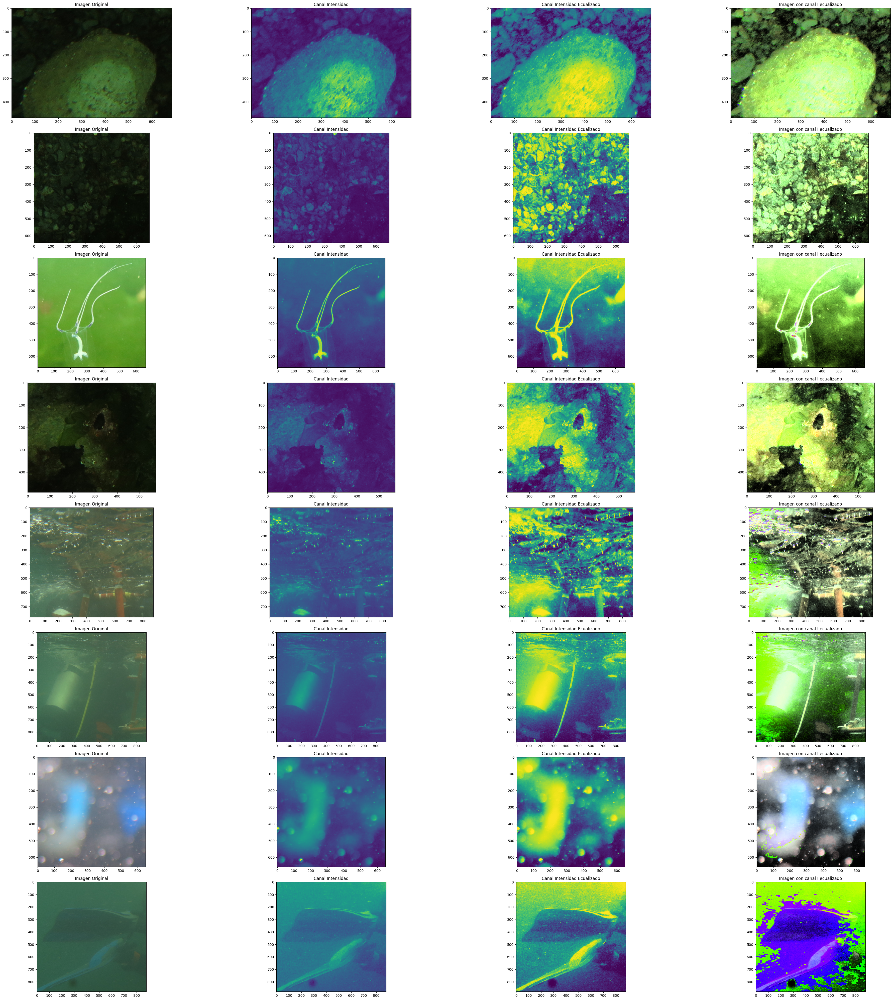

In [ ]:
# Agarro algunas imagenes
imagenes = ["1892xx.png","1892xxx.png","1901xx.png","1906ax.png","1908iv.png","1908xx.png","1923xx.png","1908xxx.png"]

fig, axes = plt.subplots(len(imagenes), 4, figsize=(16,16))

for i,imagen in enumerate(imagenes):
  imagenFilename = os.path.join("/content/Imagenes/reales", imagen)
  imagenPrueba = io.imread(imagenFilename)

  imageHSI = RGBaHSI(imagenPrueba)

  axes[i, 0].imshow(imagenPrueba)
  axes[i, 0].set_title("Imagen Original")

  axes[i,1].imshow(imageHSI[:,:,2])
  axes[i,1].set_title(f"Canal Intensidad")

  # Copio la imagen y ecualizo el canal intensidad
  imagenCopy = imageHSI.copy()
  imagenCopy[:,:,2] = exposure.equalize_hist(imagenCopy[:,:,2])
  imageRGBModificada = HSIaRGB(imagenCopy)

  axes[i,2].imshow(imagenCopy[:,:,2])
  axes[i,2].set_title(f"Canal Intensidad Ecualizado")

  axes[i,3].imshow(imageRGBModificada)
  axes[i,3].set_title(f"Imagen con canal I ecualizado")


plt.tight_layout()
plt.show()

## Granulado

Observamos que el canal Saturación es el canal donde mejor se pueden observar los cambios en el granulado de una imagen. Lo ecualizamos y observamos los resultados.

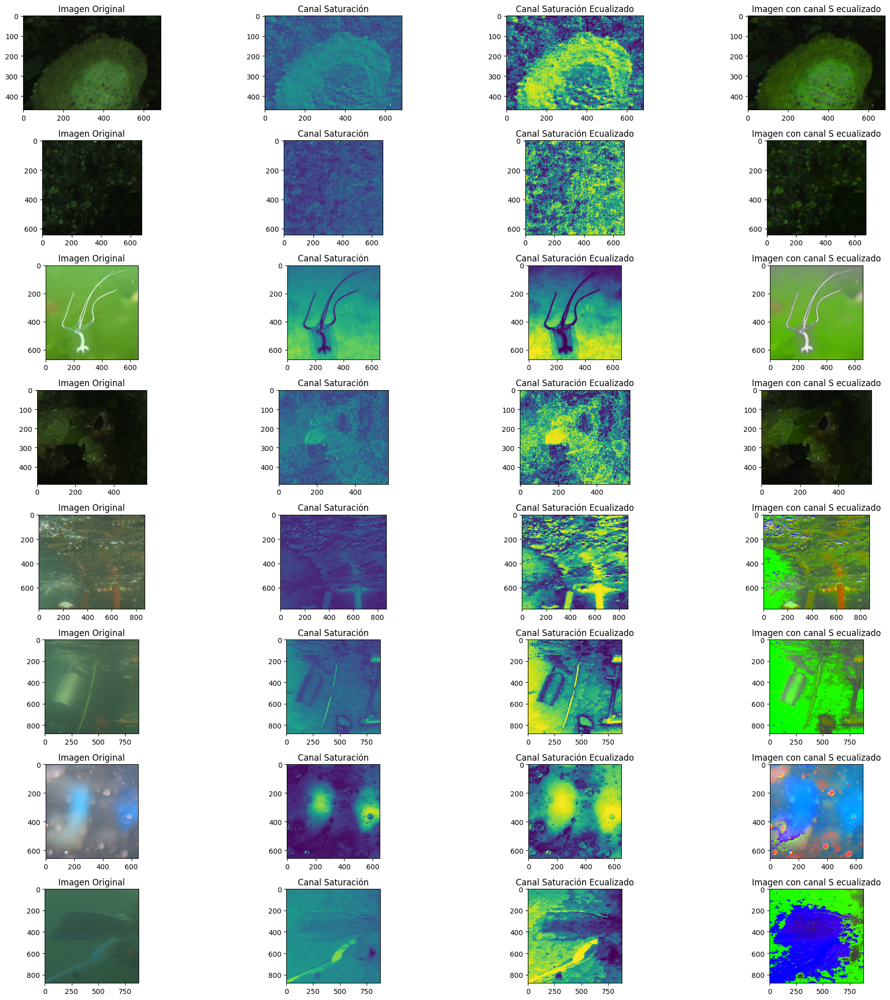

In [ ]:
# Agarro algunas imagenes
imagenes = ["1892xx.png","1892xxx.png","1901xx.png","1906ax.png","1908iv.png","1908xx.png","1923xx.png","1908xxx.png"]

fig, axes = plt.subplots(len(imagenes), 4, figsize=(16,16))

for i,imagen in enumerate(imagenes):
  imagenFilename = os.path.join("/content/Imagenes/reales", imagen)
  imagenPrueba = io.imread(imagenFilename)

  imageHSI = RGBaHSI(imagenPrueba)

  axes[i, 0].imshow(imagenPrueba)
  axes[i, 0].set_title("Imagen Original")

  axes[i,1].imshow(imageHSI[:,:,1])
  axes[i,1].set_title(f"Canal Saturación")

  # Copio la imagen y ecualizo el canal saturación
  imagenCopy = imageHSI.copy()
  imagenCopy[:,:,1] = exposure.equalize_hist(imagenCopy[:,:,1])
  imageRGBModificada = HSIaRGB(imagenCopy)

  axes[i,2].imshow(imagenCopy[:,:,1])
  axes[i,2].set_title(f"Canal Saturación Ecualizado")

  axes[i,3].imshow(imageRGBModificada)
  axes[i,3].set_title(f"Imagen con canal S ecualizado")


plt.tight_layout()
plt.show()

## Bordes difuminados

Podemos observar que los bordes difuminados influyen más en el canal de tono. Ecualizamos en este canal y vemos los resultados.

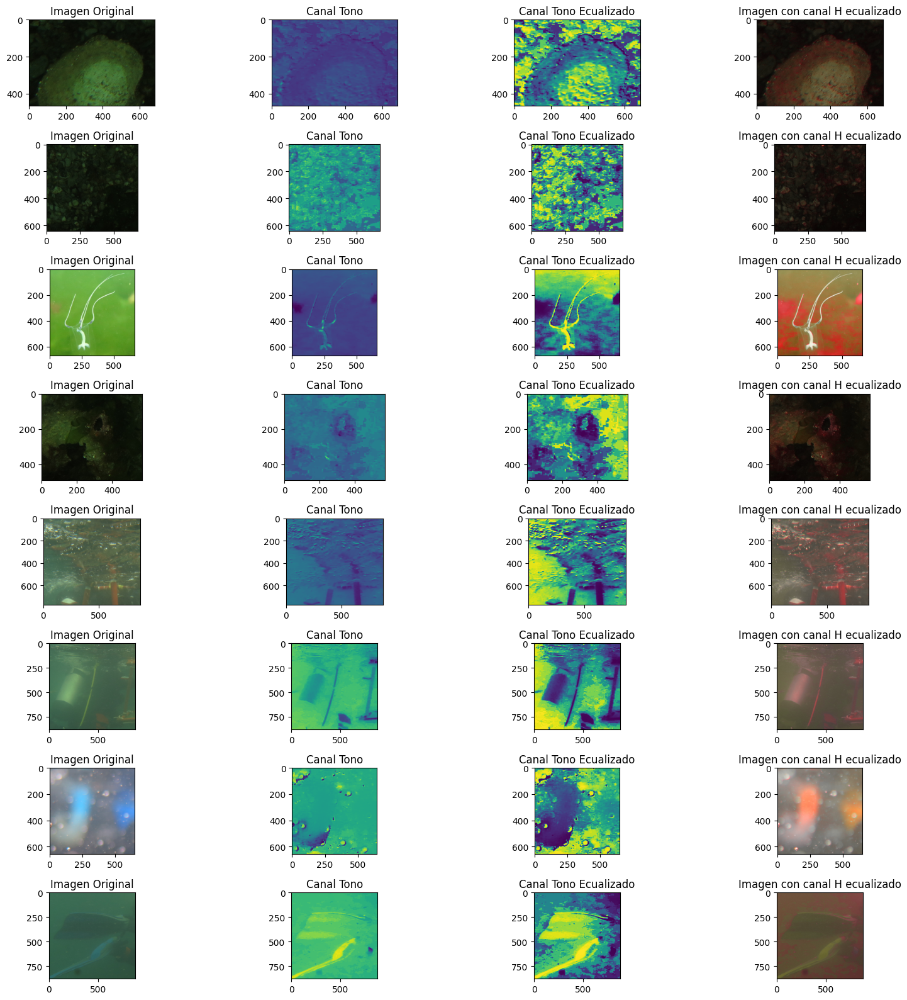

In [ ]:
# Agarro algunas imagenes
imagenes = ["1892xx.png","1892xxx.png","1901xx.png","1906ax.png","1908iv.png","1908xx.png","1923xx.png","1908xxx.png"]

fig, axes = plt.subplots(len(imagenes), 4, figsize=(16,16))

for i,imagen in enumerate(imagenes):
  imagenFilename = os.path.join("/content/Imagenes/reales", imagen)
  imagenPrueba = io.imread(imagenFilename)

  imageHSI = RGBaHSI(imagenPrueba)

  axes[i, 0].imshow(imagenPrueba)
  axes[i, 0].set_title("Imagen Original")

  axes[i,1].imshow(imageHSI[:,:,0])
  axes[i,1].set_title(f"Canal Tono")

  # Copio la imagen y ecualizo el canal saturación
  imagenCopy = imageHSI.copy()
  imagenCopy[:,:,0] = exposure.equalize_hist(imagenCopy[:,:,0])
  imageRGBModificada = HSIaRGB(imagenCopy)

  axes[i,2].imshow(imagenCopy[:,:,0])
  axes[i,2].set_title(f"Canal Tono Ecualizado")

  axes[i,3].imshow(imageRGBModificada)
  axes[i,3].set_title(f"Imagen con canal H ecualizado")


plt.tight_layout()
plt.show()

## Comparamos las imagenes con el canal I ecualizado vs. las imágenes ya procesadas

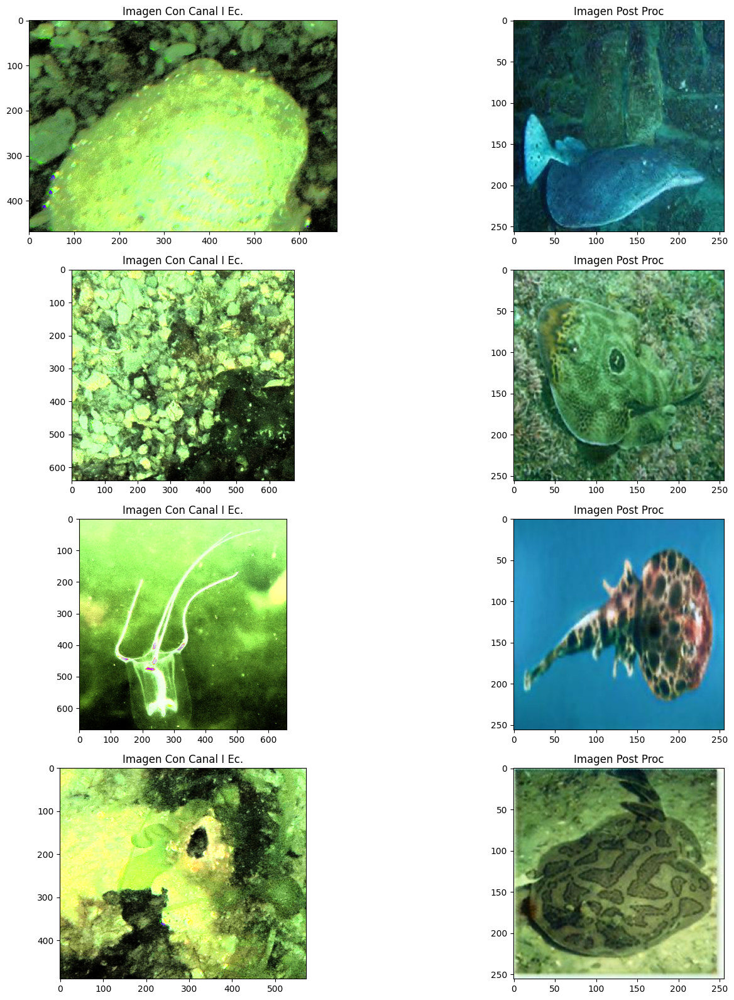

In [ ]:
# Agarro algunas imagenes
imagenes = ["1892xx.png","1892xxx.png","1901xx.png","1906ax.png"]
proc = ["n01496331_115.jpg","n01496331_175.jpg","n01496331_263.jpg","n01496331_299.jpg"]

fig, axes = plt.subplots(len(imagenes), 2, figsize=(16,16))

for i in range(len(imagenes)):
  imagen = imagenes[i]
  imagenFilename = os.path.join("/content/Imagenes/reales", imagen)
  imagenPrueba = io.imread(imagenFilename)

  imagen2 = proc[i]
  imagenFilename2 = os.path.join("/content/Imagenes/postproc", imagen2)
  imagenPrueba2 = io.imread(imagenFilename2)

  imageHSI = RGBaHSI(imagenPrueba)
  imageHSI[:,:,2] = exposure.equalize_hist(imageHSI[:,:,2])
  imageRGBModificada = HSIaRGB(imageHSI)

  axes[i, 0].imshow(imageRGBModificada)
  axes[i, 0].set_title("Imagen Con Canal I Ec.")

  axes[i,1].imshow(imagenPrueba2)
  axes[i,1].set_title(f"Imagen Post Proc")


plt.tight_layout()
plt.show()